#TP4

In [1]:
!pip install textblob-fr
!pip install unidecode
!pip install yake

  Using cached textblob_fr-0.2.0-py2.py3-none-any.whl.metadata (4.8 kB)
Using cached textblob_fr-0.2.0-py2.py3-none-any.whl (561 kB)


## Importation des bibliothèques importantes

In [122]:
import time
import os
import yake
from rake_nltk import Rake
from collections import Counter
from wordcloud import WordCloud
import nltk
nltk.download('stopwords')
from nltk.corpus import stopwords
from IPython.display import Image
import sys
import re
from nltk.tokenize import sent_tokenize
import spacy
from textblob import Blobber
from textblob_fr import PatternTagger, PatternAnalyzer
from gensim.models.phrases import Phrases, Phraser
from gensim.models import Word2Vec
from nltk.tokenize import wordpunct_tokenize
from unidecode import unidecode
import collections
import string
import pandas as pd
from nltk import word_tokenize
from pprint import pprint
from sklearn.cluster import KMeans
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.decomposition import PCA
import numpy as np
import matplotlib.pyplot as plt
from scipy.spatial.distance import cosine
import nltk
from nltk.tokenize import sent_tokenize
import shutil
from collections import defaultdict
from multiprocessing import Pool

[nltk_data] Downloading package stopwords to
[nltk_data]     /Users/bidiasmelataguia/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


In [123]:
# Instantier l'extracteur de mots clés
kw_extractor = yake.KeywordExtractor(lan="fr", top=50)
kw_extractor

### Liste de Stopwords

In [124]:
sw = stopwords.words("french")
sw += [
    "même", "t'", "s'", "n'", "l'", "d'", "c'", "ça", "y",
    "voilà", "tous", "tu", "toutes", "toutefois", "tandis que", "tant pis",
    "sous", "son", "ses", "se", "sa", "sans", "quant à", "quand", "puis",
    "pour", "plutôt", "plus", "peut", "pendant", "pas", "parfois", "parce que",
    "par", "ou bien", "ou", "on", "nous", "non", "ne", "mon", "moins", "mes",
    "mais", "ma", "là", "leur", "les", "jusqu'à", "ils", "il", "ici", "hormis",
    "faut", "faire", "fait", "être", "entre", "ensuite", "enfin", "encore",
    "elle", "donc", "doit", "dire", "depuis", "dans", "contre", "comme",
    "cette", "cet", "ces", "cela", "ceci", "ce", "car", "bientôt", "bien",
    "avoir", "avant", "après", "alors", "ainsi", "ailleurs", "tout", "deux", "abord"
]

# Suppression des doublons et transformation en set
sw = set(sw)


### Chemin vers les differents fichiers de notre travail final_text

In [125]:
data_path = "../../data/final_text/"

### Chemin vers les differents fichiers de notre travail 

In [7]:
files = [f for f in sorted(os.listdir(data_path)) if f.endswith('.txt')]

In [8]:
# taille des fichiers
files
len(files)

1000

In [9]:
# Exemple de fichiers
files[:5]

['KB_JB1051_1950-01-24_01-00001.txt',
 'KB_JB1051_1950-11-28_01-00003.txt',
 'KB_JB1051_1950-12-01_01-00004.txt',
 'KB_JB1051_1951-01-16_01-00003.txt',
 'KB_JB1051_1954-06-05_01-00001.txt']

In [10]:
# Stocker le contenu de ces fichiers dans une liste en utilisant la compréhension de liste
texts = [open(data_path + f, "r", encoding="utf-8").read() for f in files]

In [ ]:
#for text in texts:
    #for char in text:
       # print(char, end='', flush=True)
        #time.sleep(0.01)

### Ecrire tout le contenu dans un fichier temporaire

In [12]:


temp_path = '../../data/final_text/tmp_extract'

# Créer le répertoire temporaire s'il n'existe pas
if not os.path.exists(temp_path):
    os.makedirs(temp_path)
if not os.path.exists(temp_path):
    os.mkdir(temp_path)
with open(os.path.join(temp_path, f'texts.txt'), 'w', encoding='utf-8') as f:
    f.write(' '.join(texts))


### Impression du contenu du fichier et constatation des "déchets"

In [13]:
with open(os.path.join(temp_path, f'texts.txt'), 'r', encoding='utf-8') as f:
    before = f.read()

before[:500]

'( : rfyto J7 - Mardi 24 Janvier 1950 m mvmm 29* ANNEE — No 19 U No 1 tr. 50 -, m France 15 fr. Téléphone ■ 12 51 98 aprè* 20 h. : 12.93 02 C.C. i». 58 17 ORGANE CENTRAL DU PARTI COMMUNISTE DE BELGIQUE FONDATEUR: JOSEPH JACQUEMOTTE atf 33, RUE DE LA CASERNE, 33 — BRUXELLES NOS EDITIONS : *k*k*k Edition do province. *• Edition liégeoise. *k Edition do Bruxelles. LES « JAUNES » ET LA PAIX ON les voit sortir de leur Sur le plan international, niche, un à un. Depuis le socialiste Orner Becu, se- que '

In [14]:
def clean_text(folder=None):
    if folder is None:
        input_path = f"texts.txt"
        output_path = f"texts_clean.txt"
    else:
        input_path = f"{folder}/texts.txt"
        output_path = f"{folder}/texts_clean.txt"
    output = open(output_path, "w", encoding='utf-8')
    with open(input_path, 'r', encoding='utf-8') as f:
        text = f.read()
        words = nltk.wordpunct_tokenize(text)
        kept = [w.upper() for w in words if len(w) > 2 and w.isalpha() and w.lower() not in sw]
        kept_string = " ".join(kept)
        output.write(kept_string)
    return f'Output has been written in {output_path}!'

In [15]:
clean_text( folder=temp_path)

'Output has been written in ../../data/final_text/tmp_extract/texts_clean.txt!'

In [16]:
# Vérifier le résultat
with open(os.path.join(temp_path, f'texts_clean.txt'), 'r', encoding='utf-8') as f:
    after = f.read()

after[:500]

'RFYTO MARDI JANVIER MVMM ANNEE FRANCE TÉLÉPHONE APRÈ ORGANE CENTRAL PARTI COMMUNISTE BELGIQUE FONDATEUR JOSEPH JACQUEMOTTE ATF RUE CASERNE BRUXELLES EDITIONS EDITION PROVINCE EDITION LIÉGEOISE EDITION BRUXELLES JAUNES PAIX VOIT SORTIR PLAN INTERNATIONAL NICHE SOCIALISTE ORNER BECU COMITÉ ACTION RÉTAIRE INTERNATIONALE DOCKERS ANVERS TRANSPORTS EMPRESSÉ LANCÉ COURAGEUX APPEL ANNONCER ASSOCIATED DÉCHARGEMENT PRESS CONVOCATION MATÉRIEL GUERRE AMÉRICAIN MITÉ ORGANISATION CERTAINS DIRIGEANTS COMBATTRE'

#  Extraire uniquement les phrases "pertinentes" dans les documents

In [26]:
query = [
    "ordinateur",
    "calculateur",
    "machine électronique",
    "cerveau électronique",
    "robot",
    "cybernétique",
    "automatisme",
    "automatisation",
    "programmation",
    "informatique"
]


## Création d'une regex afin de trouver les mots de la liste query dans le texte

In [27]:
regex = re.compile(f"\\b({'|'.join(query)})\\b", re.IGNORECASE)

In [28]:
# Chemin vers le répertoire qui contient vos fichiers txt exportés de Camille
indir = "../../data/final_text/tmp_extract/"
# Chemin vers le répertoire qui contiendra les fichiers txt nettoyés
outdir = "../../data/final_text/tmp_extract/regex/"

# Créer les répertoires parents s'ils n'existent pas
if not os.path.exists(outdir):
    os.makedirs(outdir)

In [29]:
# Créer les répertoires parents s'ils n'existent pas
if not os.path.exists(outdir):
    os.makedirs(outdir)

print(f"Répertoire d'entrée: {indir}")
print(f"Répertoire de sortie: {outdir}")

# Exemple de traitement des fichiers (vous pouvez ajouter votre propre logique ici)
for file_name in os.listdir(indir):
    if file_name.endswith('.txt'):
        file_path = os.path.join(indir, file_name)
        with open(file_path, 'r', encoding='utf-8') as infile:
            content = infile.read()

        # Supposons que vous effectuez un nettoyage de texte ici
        cleaned_content = content.replace("foo", "bar")  # Exemple de nettoyage

        # Écrire le contenu nettoyé dans le répertoire de sortie
        output_file_path = os.path.join(outdir, file_name)
        with open(output_file_path, 'w', encoding='utf-8') as outfile:
            outfile.write(cleaned_content)

        print(f"Fichier nettoyé écrit dans {output_file_path}")

Répertoire d'entrée: ../../data/final_text/tmp_extract/
Répertoire de sortie: ../../data/final_text/tmp_extract/regex/
Fichier nettoyé écrit dans ../../data/final_text/tmp_extract/regex/texts_clean.txt
Fichier nettoyé écrit dans ../../data/final_text/tmp_extract/regex/texts.txt


In [30]:
# Lire et traiter les fichiers
for file in os.listdir(indir)[:10]:
    if file.endswith("texts_clean.txt"):
        relevant_sentences = []

        # Lire le fichier d'entrée
        with open(os.path.join(indir, file), encoding="utf-8") as f_in:
            text = f_in.read()

        # Extraire les phrases pertinentes
        for sentence in sent_tokenize(text):
            if regex.search(sentence):
                relevant_sentences.append(sentence)

        # Écrire les phrases pertinentes dans le fichier de sortie
        with open(os.path.join(outdir, file), "w", encoding="utf-8") as f_out:
            f_out.write("\n\n".join(relevant_sentences))

        print(f"Fichier traité et écrit : {file}")

Fichier traité et écrit : texts_clean.txt


In [22]:
# Vérifier le résultat
with open(os.path.join(outdir, f'texts_clean.txt'), 'r', encoding='utf-8') as f:
    after = f.read()

after[:500]

'RFYTO MARDI JANVIER MVMM ANNEE FRANCE TÉLÉPHONE APRÈ ORGANE CENTRAL PARTI COMMUNISTE BELGIQUE FONDATEUR JOSEPH JACQUEMOTTE ATF RUE CASERNE BRUXELLES EDITIONS EDITION PROVINCE EDITION LIÉGEOISE EDITION BRUXELLES JAUNES PAIX VOIT SORTIR PLAN INTERNATIONAL NICHE SOCIALISTE ORNER BECU COMITÉ ACTION RÉTAIRE INTERNATIONALE DOCKERS ANVERS TRANSPORTS EMPRESSÉ LANCÉ COURAGEUX APPEL ANNONCER ASSOCIATED DÉCHARGEMENT PRESS CONVOCATION MATÉRIEL GUERRE AMÉRICAIN MITÉ ORGANISATION CERTAINS DIRIGEANTS COMBATTRE'

### Afficher les termes les plus fréquents


In [31]:
frequencies = Counter(after.split())
print(frequencies.most_common(20))

[('ROSSEL', 42033), ('DEM', 30694), ('BRUXELLES', 19797), ('RUE', 19772), ('ECRIRE', 17926), ('ANS', 16235), ('AGENCE', 16169), ('DEMANDE', 14141), ('TÉL', 13856), ('ECR', 12967), ('DACTYLO', 10479), ('IMPORTANTE', 9092), ('BON', 8676), ('FIRME', 8338), ('CHERCHE', 8016), ('PRÉS', 8014), ('TRÈS', 7240), ('PLACE', 7037), ('OFFRE', 6879), ('BONNE', 6469)]


# Nuage de mots

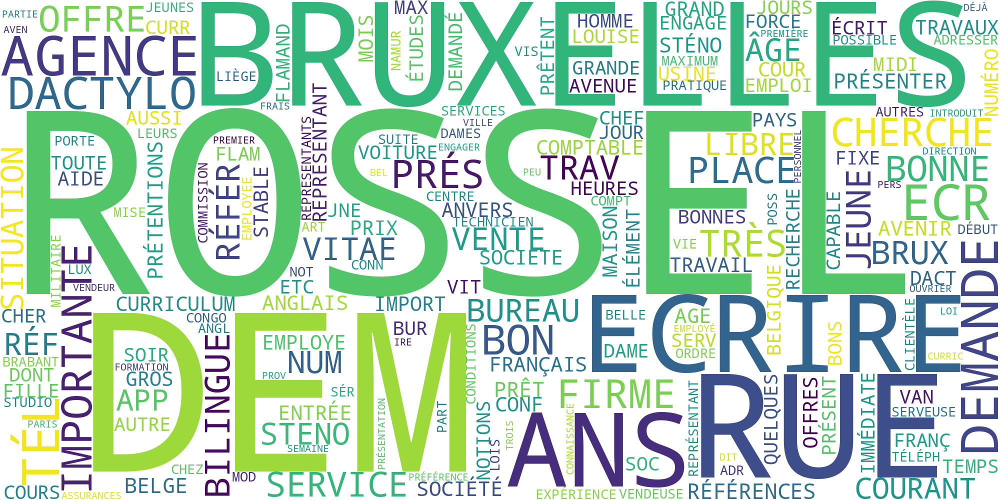

In [32]:
cloud = WordCloud(width=2000, height=1000, background_color='white').generate_from_frequencies(frequencies)
cloud.to_file(os.path.join(temp_path, f"texts.png"))
Image(filename=os.path.join(temp_path, f"texts.png"))

In [25]:
this_file = files
this_file

['KB_JB1051_1950-01-24_01-00001.txt',
 'KB_JB1051_1950-11-28_01-00003.txt',
 'KB_JB1051_1950-12-01_01-00004.txt',
 'KB_JB1051_1951-01-16_01-00003.txt',
 'KB_JB1051_1954-06-05_01-00001.txt',
 'KB_JB1051_1954-10-06_01-00002.txt',
 'KB_JB1051_1956-01-11_01-00004.txt',
 'KB_JB1051_1956-07-13_01-00004.txt',
 'KB_JB1051_1956-08-23_01-00004.txt',
 'KB_JB1051_1956-09-18_01-00004.txt',
 'KB_JB1051_1957-08-20_01-00001.txt',
 'KB_JB1051_1957-10-03_01-00004.txt',
 'KB_JB1051_1957-11-28_01-00003.txt',
 'KB_JB1051_1958-02-21_01-00001.txt',
 'KB_JB1051_1958-05-13_01-00004.txt',
 'KB_JB1051_1958-06-17_01-00001.txt',
 'KB_JB1051_1958-09-24_01-00004.txt',
 'KB_JB1051_1958-10-21_01-00004.txt',
 'KB_JB1051_1959-07-24_01-00001.txt',
 'KB_JB1051_1959-10-14_01-00002.txt',
 'KB_JB1051_1959-12-16_01-00004.txt',
 'KB_JB1051_1960-02-17_01-00004.txt',
 'KB_JB1051_1960-11-08_01-00003.txt',
 'KB_JB421_1950-01-12_01-00003.txt',
 'KB_JB421_1950-06-04_01-00005.txt',
 'KB_JB421_1950-06-09_01-00002.txt',
 'KB_JB421_1950

In [33]:
# Initialisation de liste pour stocker les textes
texts_n = []

# Parcourir la liste des noms de fichiers
for this_file in this_file:
    file_path = os.path.join(data_path, this_file)
    
    # Vérifier si le fichier existe
    if os.path.exists(file_path):
        # Lecture du contenu du fichier et stockage dans la liste
        with open(file_path, 'r', encoding='utf-8') as file:
            file_text = file.read()
            texts_n.append(file_text)

In [34]:
# Extraire les mots clés de ce texte
keywords = kw_extractor.extract_keywords(file_text)
keywords

[('dem', 0.006237973711090268),
 ('rue', 0.00961702366486407),
 ('Bruxelles', 0.011008078147911462),
 ('Tél', 0.012945606575962412),
 ('Ecrire', 0.016905655542158702),
 ('prés', 0.01719821408054426),
 ('Ecrire Agence', 0.018321368087995952),
 ('Agence Rossel', 0.019358204546663305),
 ('studio', 0.022227704535364313),
 ('Ecrire Agence Rossel', 0.02365713078348375),
 ('Rossel', 0.023724822831462704),
 ('Agence', 0.025243562337627343),
 ('Place', 0.02585797469206783),
 ('ans', 0.026855555762805603),
 ('Jeune', 0.03162856274941009),
 ('serveuse', 0.032299757525088554),
 ('Rosscl', 0.035140494599790205),
 ('service', 0.036195125919293046),
 ('demande', 0.036868706114407554),
 ('présenter', 0.03691833014221105),
 ('Agence HAVAS Bruxelles', 0.03693688604930127),
 ('Brux', 0.038105353953702764),
 ('FLAMME BLEUE Valor', 0.04232773423540075),
 ('vitae', 0.048474991999646506),
 ('bonnes', 0.048590211673062565),
 ('DACTYLOS BILINGUES Ecrire', 0.049967062971469675),
 ('VALOR', 0.05395835595994102),

In [35]:
# Ne garder que les bigrammes
kept = []
for kw, score in keywords:
    words = kw.split()
    if len(words) == 2:
        kept.append(kw)
kept

['Ecrire Agence',
 'Agence Rossel',
 'bonnes notions',
 'Agence HAVAS',
 'Café dem',
 'IMPORTANTE SOCIETE',
 'présenter Service']

# Evolution de notions liés à l'informatique au fil des années 

## Chemin contenant les fichiers à organiser

In [36]:
data_path = "../../data/final_text/"

# Créer un dossier par année entre 1950 et 1960
for year in range(1950, 1961):
    year_folder = f"../../data/final_text/{year}"
    os.makedirs(year_folder, exist_ok=True)




### Récupération de la liste des fichiers dans le dossier source

In [37]:
files = os.listdir(data_path)



### Parcour des fichiers et les déplacement dans les dossiers annuels correspondants

In [ ]:
for file in files:
    try:
        year = int(file.split('_')[2].split('-')[0])
    except (ValueError, IndexError):
        continue  

    # Construire les chemins source et destination
    source_path = os.path.join(data_path, file)
    destination_path = os.path.join(data_path, str(year), file)
    print(f"Moving {file} from {source_path} to {destination_path}")

    try:
        # Effectuer le déplacement du fichier
        shutil.move(source_path, destination_path)
        print(f"Successfully moved {file}")
    except Exception as e:
        print(f"Error moving {file}: {e}")


### Chemin vers le répertoire principal

In [39]:
data_path = "../../data/final_text/"

### Liste des années et nombre de fichiers par années

In [42]:
years = list(range(1950, 1961))
file_counts = []

### Parcour des années et graphique

In [ ]:

for year in years:
    year_folder = os.path.join(data_path, str(year))
    if os.path.exists(year_folder):
        files_in_year = len(os.listdir(year_folder))
        file_counts.append(files_in_year)
    else:
        file_counts.append(0)

# Tracer le graphique
plt.plot(years, file_counts, marker='o')
plt.title('Nombre de fichiers par année')
plt.xlabel('Année')
plt.ylabel('Nombre de fichiers')
plt.grid(True)
plt.show()

# Etude des corpus en fonctions des intervalles d'annees ou annees

In [45]:
data_path = "../../data/final_text/"

### Intervalles d'années à extraire et stocker

In [133]:
start_year = 1956
end_year = 1960
N_files = []

### Parcour des années

In [134]:
for year in range(start_year, end_year + 1):
    year_folder = os.path.join(data_path, str(year))
    N_files.extend([os.path.join(year_folder, f) for f in sorted(os.listdir(year_folder)) if f.endswith('.txt')])

# Afficher les noms de fichiers
print(N_files)

['../../data/final_text/1956/KB_JB1051_1956-01-11_01-00004.txt', '../../data/final_text/1956/KB_JB1051_1956-07-13_01-00004.txt', '../../data/final_text/1956/KB_JB1051_1956-08-23_01-00004.txt', '../../data/final_text/1956/KB_JB1051_1956-09-18_01-00004.txt', '../../data/final_text/1956/KB_JB838_1956-01-01_01-00014.txt', '../../data/final_text/1956/KB_JB838_1956-01-03_01-00012.txt', '../../data/final_text/1956/KB_JB838_1956-01-04_01-00005.txt', '../../data/final_text/1956/KB_JB838_1956-01-04_01-00014.txt', '../../data/final_text/1956/KB_JB838_1956-01-07_01-00015.txt', '../../data/final_text/1956/KB_JB838_1956-01-14_01-00005.txt', '../../data/final_text/1956/KB_JB838_1956-01-15_01-00016.txt', '../../data/final_text/1956/KB_JB838_1956-01-19_01-00019.txt', '../../data/final_text/1956/KB_JB838_1956-01-20_01-00002.txt', '../../data/final_text/1956/KB_JB838_1956-01-22_01-00018.txt', '../../data/final_text/1956/KB_JB838_1956-01-24_01-00014.txt', '../../data/final_text/1956/KB_JB838_1956-01-30_01

### Nombre de fichiers 

In [135]:
len(N_files)

587

### Stockage du contenu de ces fichiers dans une liste 

In [136]:
N_texts = [open(f, "r", encoding="utf-8").read() for f in N_files]

### Ecrire tout le contenu dans un fichier temporaire

In [137]:
temp_path = '../../data/final_text/tmp_extract'
if not os.path.exists(temp_path):
    os.mkdir(temp_path)
with open(os.path.join(temp_path, f'N_texts.txt'), 'w', encoding='utf-8') as f:
    f.write(' '.join(N_texts))

In [ ]:
# Imprimer le contenu du fichier et constater les "déchets"
with open(os.path.join(temp_path, f'N_texts.txt'), 'r', encoding='utf-8') as f:
    before = f.read()

before[:500]

In [140]:
def clean_text(folder=None):
    if folder is None:
        input_path = f"N_texts.txt"
        output_path = f"N_texts_clean.txt"
    else:
        input_path = f"{folder}/N_texts.txt"
        output_path = f"{folder}/N_texts_clean.txt"
    output = open(output_path, "w", encoding='utf-8')
    with open(input_path, 'r', encoding='utf-8') as f:
        text = f.read()
        words = nltk.wordpunct_tokenize(text)
        kept = [w.upper() for w in words if len(w) > 2 and w.isalpha() and w.lower() not in sw]
        kept_string = " ".join(kept)
        output.write(kept_string)
    return f'Output has been written in {output_path}!'

In [ ]:
clean_text( folder=temp_path)

In [142]:
# Vérifier le résultat
with open(os.path.join(temp_path, f'texts_clean.txt'), 'r', encoding='utf-8') as f:
    after = f.read()

after[:500]

'RFYTO MARDI JANVIER MVMM ANNEE FRANCE TÉLÉPHONE APRÈ ORGANE CENTRAL PARTI COMMUNISTE BELGIQUE FONDATEUR JOSEPH JACQUEMOTTE ATF RUE CASERNE BRUXELLES EDITIONS EDITION PROVINCE EDITION LIÉGEOISE EDITION BRUXELLES JAUNES PAIX VOIT SORTIR PLAN INTERNATIONAL NICHE SOCIALISTE ORNER BECU COMITÉ ACTION RÉTAIRE INTERNATIONALE DOCKERS ANVERS TRANSPORTS EMPRESSÉ LANCÉ COURAGEUX APPEL ANNONCER ASSOCIATED DÉCHARGEMENT PRESS CONVOCATION MATÉRIEL GUERRE AMÉRICAIN MITÉ ORGANISATION CERTAINS DIRIGEANTS COMBATTRE'

In [144]:
query = [
    "ordinateur",
    "calculateur",
    "machine électronique",
    "cerveau électronique",
    "robot",
    "cybernétique",
    "automatisme",
    "automatisation",
    "programmation",
    "téléphone",
    "informatique"
]


### Création d'une regex afin de trouver les mots de la liste query dans le texte

In [145]:
regex = re.compile(f"\\b({'|'.join(query)})\\b", re.IGNORECASE)

In [146]:
# Le répertoire qui contient vos fichiers txt exportés de Camille
indir = "../../data/final_text/tmp_extract/"
# Le répertoire qui contiendra les fichiers txt nettoyés
outdir = "../../data/final_text/tmp_extract/regex/"

if not os.path.exists(outdir):
    os.mkdir(outdir)

In [147]:
for file in os.listdir(indir)[:10]:
    if file.endswith("N_texts_clean.txt"):
        relevant_sentences = []
        f_in = open(os.path.join(indir, file), encoding="utf-8")
        text = f_in.read()
        for sentence in sent_tokenize(text):
            if regex.search(sentence):
                relevant_sentences.append(sentence)
        f_in.close()
        f_out = open(os.path.join(outdir, file), "w", encoding="utf-8")
        f_out.write("\n\n".join(relevant_sentences))
        f_out.close()

In [ ]:
# Vérifier le résultat
with open(os.path.join(outdir, f'N_texts_clean.txt'), 'r', encoding='utf-8') as f:
    after = f.read()

after[:500]

In [ ]:
frequencies = Counter(after.split())
print(frequencies.most_common(50))

In [ ]:
cloud = WordCloud(width=2000, height=1000, background_color='white').generate_from_frequencies(frequencies)
cloud.to_file(os.path.join(temp_path, f"N_texts.png"))
Image(filename=os.path.join(temp_path, f"N_texts.png"))

# Les mots clés de mon sous corpus 

### Ngram

In [ ]:
import yake

# Charger le texte
with open("../../data/final_text/tmp_extract/regex/N_texts_clean.txt", 'r', encoding="utf-8") as file:
    file_text = file.read()

# Initialiser YAKE pour extraire des n-grammes de taille 1 à 2
keyword_results = {}
for n in range(1, 3):  # unigrams à 2-grams
    extractor = yake.KeywordExtractor(lan="fr", n=n, top=15)
    keywords = extractor.extract_keywords(file_text)
    keyword_results[f"{n}-gram"] = keywords

# Afficher les résultats
for gram_type, kws in keyword_results.items():
    print(f"\n{gram_type.upper()} :")
    for kw, score in kws:
        print(f"  - {kw} (score: {score:.4f})")


## Les noms des personnes et des endroits technologique

### Initialisation du modèle SpaCy pour le français

In [154]:
nlp = spacy.load("fr_core_news_sm")

### Charger et traiter le texte

In [155]:
n = 1000000
text = open("../../data/final_text/tmp_extract/regex/N_texts_clean.txt", encoding='utf-8').read()[:n]
doc = nlp(text)

### Compter les entités

In [156]:

people = defaultdict(int)
locations = defaultdict(int)

for ent in doc.ents:
    if ent.label_ == "PER" and len(ent.text) > 3:
        people[ent.text] += 1
    elif ent.label_ == "LOC":
        locations[ent.text] += 1



### Trier et imprimer les personnes

In [ ]:
sorted_people = sorted(people.items(), key=lambda kv: kv[1], reverse=True)
print("\nPersonnes les plus mentionnées :")
for person, freq in sorted_people[:20]:
    print(f"{person} apparait {freq} fois dans le corpus")



### Trier et imprimer les lieux

In [ ]:
sorted_locations = sorted(locations.items(), key=lambda kv: kv[1], reverse=True)
print("\nLieux les plus mentionnés :")
for location, freq in sorted_locations[:20]:
    print(f"{location} apparait {freq} fois dans le corpus")

# SEGMENTATION POUR LE WORD_EMBEDDING

### Fichiers d'inputs et d'outputs

In [81]:
infile = "../../data/final_text/tmp_extract/texts_clean.txt"
outfile = "../../data/final_text/tmp_extract/regex/text_seg.txt"

## Segmentation en phrases du corpus complet et création d'un nouveau fichier

In [82]:
LIMIT = 1000000

In [83]:
with open(outfile, 'w', encoding="utf-8") as output:
    with open(infile, encoding="utf-8", errors="backslashreplace") as f:
        content = f.readlines()
        content = content[:LIMIT] if LIMIT is not None else content
        n_lines = len(content)
        for i, line in enumerate(content):
            if i % 100 == 0:
                print(f'processing line {i}/{n_lines}')
            sentences = sent_tokenize(line)
            for sent in sentences:
                output.write(sent + "\n")
print("Done")

processing line 0/1
Done


# Word_Embedding

# crreation d'un objet streame

In [84]:
class MySentences(object):
    """Tokenize and Lemmatize sentences"""
    def __init__(self, filename):
        self.filename = filename

    def __iter__(self):
        for line in open(self.filename, encoding='utf-8', errors="backslashreplace"):
            yield [unidecode(w.lower()) for w in wordpunct_tokenize(line)]

In [85]:
infile = f"../../data/final_text/tmp_extract/regex/text_seg.txt"
sentences = MySentences(infile)

# Detection des bigrams

In [86]:
bigram_phrases = Phrases(sentences)

In [87]:
type(bigram_phrases.vocab)

dict

In [88]:
len(bigram_phrases.vocab.keys())

1791501

In [89]:
key_ = list(bigram_phrases.vocab.keys())[144]
print(key_)

abriter_derriere


In [90]:
bigram_phrases.vocab[key_]

2

# conversion des Phrases en objet Phraser

In [91]:
bigram_phraser = Phraser(phrases_model=bigram_phrases)

# Extraction trigrams

In [92]:
trigram_phrases = Phrases(bigram_phraser[sentences])

In [93]:
trigram_phraser = Phraser(phrases_model=trigram_phrases)

# creation corpus avec unigrams, bi , tri 

In [94]:
corpus = list(trigram_phraser[bigram_phraser[sentences]])

In [95]:
print(corpus[:10])

[['rfyto', 'mardi_janvier', 'mvmm', 'annee', 'france', 'telephone', 'apre', 'organe', 'central_parti', 'communiste', 'belgique', 'fondateur', 'joseph', 'jacquemotte', 'atf', 'rue_caserne', 'bruxelles', 'editions', 'edition', 'province', 'edition', 'liegeoise', 'edition', 'bruxelles', 'jaunes', 'paix', 'voit', 'sortir', 'plan_international', 'niche', 'socialiste', 'orner', 'becu', 'comite_action', 'retaire', 'internationale', 'dockers', 'anvers', 'transports', 'empresse', 'lance', 'courageux', 'appel', 'annoncer', 'associated', 'dechargement', 'press', 'convocation', 'materiel_guerre', 'americain', 'mite', 'organisation', 'certains', 'dirigeants', 'combattre', 'efforts', 'faix', 'commencent', 'aboyer', 'dockers', 'anvers', 'orner', 'chose', 'ahurissante', 'becu', 'essaye', 'nom', 'defense', 'reven', 'abriter', 'derriere', 'paravent', 'dications', 'ouvrieres', 'con', 'pretendument', 'revendicatif', 'testent', 'dockers', 'droit', 'bonne', 'raison', 'lutter', 'faix', 'souvient', 'laissez',

In [ ]:
from gensim.models import Word2Vec
import logging

# Configurez le logging
logging.basicConfig(format='%(asctime)s : %(levelname)s : %(message)s', level=logging.INFO)


# Définir différentes valeurs pour window, min_count, vector_size, et epochs
window_values = [5, 7, 10]
min_count_values = [3, 5, 8] # Réduire min_count pour ne pas exclure trop de mots clés
vector_size_values = [64, 128, 256] # Tester des tailles de vecteurs plus grandes
epochs_values = [10, 20, 30] # Augmenter le nombre d'epochs

# Définir des paires de mots clés pour l'évaluation de la similarité
# Ces paires doivent être pertinentes pour votre thématique et dont vous attendez une similarité élevée
test_pairs_positive = [
    ("ordinateur", "machine"),
    ("calculateur", "ordinateur"),
    ("automatisation", "travail"),
    ("robot", "machine"),
    ("cybernétique", "automatisme"), # Assurez-vous que ces mots peuvent être dans le corpus
    ("emploi", "travail")
]
# Faible similarité pour vérifier la discrimination du modèle
test_pairs_negative = [
    ("ordinateur", "chaise"),
    ("robot", "fleur"),
    ("travail", "nuage")
]

best_model = None
best_composite_score = -float('inf') # Initialiser avec un score très bas

# Paramètres du meilleur modèle
best_params = {}

for window_size in window_values:
    for min_count_value in min_count_values:
        for v_size in vector_size_values:
            for num_epochs in epochs_values:
                print(f"Entraînement avec window={window_size}, min_count={min_count_value}, "
                      f"vector_size={v_size}, epochs={num_epochs}")

                # Entraînement du modèle (utiliser Skip-gram pour de meilleurs résultats sémantiques)
                model = Word2Vec(
                    corpus,
                    vector_size=v_size,
                    window=window_size,
                    min_count=min_count_value,
                    workers=4,
                    epochs=num_epochs,
                    sg=1, # Utiliser Skip-gram
                    negative=10 # Ajout du negative sampling, une bonne valeur est souvent entre 5 et 20
                )

                current_composite_score = 0
                num_eval_pairs = 0

                # Évaluation des similarités pour les paires positives
                for w1, w2 in test_pairs_positive:
                    if w1 in model.wv.key_to_index and w2 in model.wv.key_to_index:
                        sim = model.wv.similarity(w1, w2)
                        current_composite_score += sim # Ajouter le score de similarité
                        num_eval_pairs += 1
                        print(f"  Sim('{w1}', '{w2}') = {sim:.4f}")
                    else:
                        print(f"  Mots '{w1}' ou '{w2}' non trouvés dans le vocabulaire.")
                        # Pénaliser si les mots clés importants ne sont pas présents
                        current_composite_score -= 1.0 # Forte pénalité si une paire clé manque

                # Évaluation des similarités pour les paires négatives (optionnel, mais bon pour vérifier la discrimination)
                for w1, w2 in test_pairs_negative:
                    if w1 in model.wv.key_to_index and w2 in model.wv.key_to_index:
                        sim = model.wv.similarity(w1, w2)
                        current_composite_score -= sim # Soustraire le score pour qu'un score faible soit bon
                        num_eval_pairs += 1
                        print(f"  Sim('{w1}', '{w2}') = {sim:.4f} (négatif attendu)")
                    else:
                        # Moins critique si les mots des paires négatives manquent, mais à noter
                        print(f"  Mots '{w1}' ou '{w2}' non trouvés dans le vocabulaire pour la paire négative.")

                # Calcul du score moyen si des paires ont été évaluées
                if num_eval_pairs > 0:
                    pass
                else:
                    current_composite_score = -float('inf') # Si aucune paire n'a pu être évaluée, c'est un très mauvais modèle

                print(f"Score composite obtenu pour ce modèle : {current_composite_score:.4f}\n")

                # Comparaison avec le meilleur modèle précédent
                if current_composite_score > best_composite_score:
                    best_composite_score = current_composite_score
                    best_model = model
                    best_params = {
                        "window": window_size,
                        "min_count": min_count_value,
                        "vector_size": v_size,
                        "epochs": num_epochs,
                        "sg": 1,
                        "negative": 10
                    }

print("\n--- Entraînement terminé ---")
print(f"Meilleur score composite : {best_composite_score:.4f}")
print(f"Meilleurs paramètres : {best_params}")


In [ ]:
outfile = f"../../data/newspapers_n.model"
model.save(outfile)

In [ ]:
model = Word2Vec.load("../../data/newspapers_n.model")

In [ ]:
model.wv["ordinateur"]

In [ ]:
try:
    similarity_score = model.wv.similarity("ordinateur", "travail")
    print(f"Similarité entre 'ordinateur' et 'travail' : {similarity_score:.4f}")
except KeyError as e:
    print(f"Erreur : Un des mots n'est pas dans le vocabulaire du modèle. {e}")

In [ ]:
similarity_robot_homme = model.wv.similarity("robot", "homme")
print(f"Similarité entre 'robot' et 'homme' : {similarity_robot_homme:.4f}")

In [ ]:
similarity_ordinateur_emploi = model.wv.similarity("ordinateur", "emploi")
print(f"Similarité entre 'ordinateur' et 'emploi' : {similarity_ordinateur_emploi:.4f}")

In [ ]:
similar_words = model.wv.most_similar("ordinateur", topn=5)

# Affichez les mots similaires
for word, score in similar_words:
    print(word, score)

In [ ]:
print(model.wv.most_similar(positive=['calculateur', 'ordinateur']))
print("\n")

In [ ]:
# Affichage des termes sémantiquement proches des mots 'programme' et 'ordinateur'
print("Termes les plus similaires à 'programme' et 'ordinateur' :")
print(model.wv.most_similar(positive=['programme', 'ordinateur']))
print("\n")


In [ ]:
if 'ordinateur' in model.wv.key_to_index and 'machine' in model.wv.key_to_index:
    print("Termes associés au vocabulaire technologique :")
    print(model.wv.most_similar(positive=['ordinateur', 'machine']))
    print("\n")
else:
    print("Un ou plusieurs mots clés ne sont pas présents dans le vocabulaire du modèle.")


In [ ]:

# Exploration des attributs technologiques
print("Exploration des attributs technologiques - Puissant vs Rapide:")
print(model.wv.most_similar(positive=['ordinateur', 'puissant'], negative=['rapide']))

In [ ]:
from gensim.models import Word2Vec
import logging

# Configurez le logging pour voir les messages de Word2Vec
logging.basicConfig(format='%(asctime)s : %(levelname)s : %(message)s', level=logging.INFO)

# Chargez le modèle Word2Vec
# Assurez-vous que le chemin est correct et que le modèle existe
try:
    model = Word2Vec.load("../../data/newspapers_n.model")
    print("Modèle Word2Vec chargé avec succès.")
except FileNotFoundError:
    print("Erreur: Le fichier du modèle Word2Vec n'a pas été trouvé. Vérifiez le chemin.")
    # Sortir ou gérer l'erreur si le modèle ne peut pas être chargé
    exit()
except Exception as e:
    print(f"Une erreur s'est produite lors du chargement du modèle : {e}")
    exit()

# Vérifier la présence d'un mot avant de tenter de l'accéder
def get_similarities(word1, word2, model):
    if word1 in model.wv.key_to_index and word2 in model.wv.key_to_index:
        similarity_score = model.wv.similarity(word1, word2)
        print(f"Similarité entre '{word1}' et '{word2}' : {similarity_score:.4f}")
    else:
        print(f"Erreur : Un des mots ('{word1}' ou '{word2}') n'est pas dans le vocabulaire du modèle.")

def get_most_similar(word, model, topn=5):
    if word in model.wv.key_to_index:
        print(f"\nMots les plus similaires à '{word}' (Top {topn}) :")
        similar_words = model.wv.most_similar(word, topn=topn)
        for w, score in similar_words:
            print(f"- {w}: {score:.4f}")
    else:
        print(f"\nErreur : Le mot '{word}' n'est pas dans le vocabulaire du modèle.")

def perform_analogy(positive_words, negative_words, model, topn=5):
    # Convertir les listes en sets pour une vérification rapide
    all_words = set(positive_words + negative_words)
    
    # Vérifier que tous les mots sont dans le vocabulaire
    missing_words = [w for w in all_words if w not in model.wv.key_to_index]
    
    if not missing_words:
        print(f"\nAnalogie : {' + '.join(positive_words)} - {' - '.join(negative_words)} (Top {topn}) :")
        try:
            results = model.wv.most_similar(positive=positive_words, negative=negative_words, topn=topn)
            for w, score in results:
                print(f"- {w}: {score:.4f}")
        except KeyError as e:
            print(f"Une erreur d'analogie est survenue : {e}")
    else:
        print(f"\nErreur : Les mots suivants ne sont pas dans le vocabulaire pour l'analogie : {', '.join(missing_words)}")


print("\n--- Analyse des similarités entre paires de mots ---")
# Similarité entre 'ordinateur' et 'travail'
get_similarities("ordinateur", "travail", model)
# Similarité entre 'robot' et 'homme'
get_similarities("robot", "homme", model)
# Similarité entre 'ordinateur' et 'emploi'
get_similarities("ordinateur", "emploi", model)
# Nouvelle paire de similarité : 'ordinateur' et 'machine'
get_similarities("ordinateur", "machine", model)
# Nouvelle paire de similarité : 'automatisation' et 'avenir'
get_similarities("automatisation", "avenir", model)
# Nouvelle paire de similarité : 'calculateur' et 'industrie'
get_similarities("calculateur", "industrie", model)
# Nouvelle paire de similarité : 'bureautique' et 'progrès' (si 'bureautique' est un terme pertinent dans le corpus)
get_similarities("bureautique", "progrès", model)


print("\n--- Exploration des mots les plus similaires ---")
# Mots les plus similaires à 'ordinateur'
get_most_similar("ordinateur", model, topn=5)
# Mots les plus similaires à 'calculateur'
get_most_similar("calculateur", model, topn=5)
# Mots les plus similaires à 'robot'
get_most_similar("robot", model, topn=5)
# Mots les plus similaires à 'automatisation'
get_most_similar("automatisation", model, topn=5)
# Mots les plus similaires à 'travail'
get_most_similar("travail", model, topn=5)
# Mots les plus similaires à 'progrès'
get_most_similar("progrès", model, topn=5)
# Mots les plus similaires à 'avenir'
get_most_similar("avenir", model, topn=5)


print("\n--- Exploration des analogies (relations sémantiques) ---")
# Analogie classique : si 'roi' est à 'homme' ce que 'reine' est à 'femme' (exemple conceptuel)
# Si 'calculateur' est à 'chiffres' ce que 'cerveau' est à 'idées' (adapté à la thématique)
perform_analogy(positive_words=['cerveau', 'chiffres'], negative_words=['calculateur'], model=model, topn=5) # 'chiffres' - 'calculateur' + 'cerveau'
# Si 'ordinateur' est à 'technologie' ce que 'usine' est à 'production'
perform_analogy(positive_words=['production', 'ordinateur'], negative_words=['usine'], model=model, topn=5)
# Si 'dactylo' est à 'machine' ce que 'employé' est à 'bureau'
perform_analogy(positive_words=['bureau', 'dactylo'], negative_words=['machine'], model=model, topn=5)
# Relations conceptuelles : ce qui rend un 'ordinateur' moderne par rapport à un 'calculateur' ancien
perform_analogy(positive_words=['moderne', 'ordinateur'], negative_words=['calculateur'], model=model, topn=5)
# Exploration des attributs : 'ordinateur' est puissant mais pas lent
perform_analogy(positive_words=['ordinateur', 'puissant'], negative_words=['lent'], model=model, topn=5)


print("\n--- Termes sémantiquement proches (combinaisons) ---")
# Termes sémantiquement proches des mots 'calculateur' et 'ordinateur'
perform_analogy(positive_words=['calculateur', 'ordinateur'], negative_words=[], model=model, topn=5) # Equivaut à most_similar avec plusieurs positifs
# Termes associés au vocabulaire technologique : 'ordinateur' et 'machine'
perform_analogy(positive_words=['ordinateur', 'machine'], negative_words=[], model=model, topn=5)
# Termes associés à l'impact sur l'emploi : 'ordinateur' et 'emploi'
perform_analogy(positive_words=['ordinateur', 'emploi'], negative_words=[], model=model, topn=5)
# Termes associés à l'évolution : 'cybernétique' et 'futur'
perform_analogy(positive_words=['cybernétique', 'futur'], negative_words=[], model=model, topn=5)

print("\nAnalyse Word2Vec terminée.")